### Spatial mapping of human lung region snRNA-seq to Visium (for Elo) - with scVI non-amortised inference

In [1]:
import sys
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/scvi-tools/')

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

#import cell2location
import scvi

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

`THEANO_FLAGS='force_device=True'` forces the package to use GPU. Pay attention to error messages that might indicate theano failed to initalise the GPU.   
Do not forget to change `device=cuda4` to your available GPU id. Use `device=cuda` / `device=cuda0` if you have just one locally or if you are requesting one GPU via HPC cluster job.

### Outline

1. Loading Visium data and single cell reference
2. Show UMAP of cells and locations
3. cell2location analysis in one step
4. Automatic discrete region identification by clustering cell densities
5. Visualize cell type density gradients using diffusion maps
6. Identify co-occuring cell type combinations using matrix factorisation



## 1. Loading Visium data and single cell reference

First let's read spatial Visium data from 10X Space Ranger output. Here we load sample annotations.

In [2]:
#sp_data_folder = '/sanger_projects/large_data/lung_airway_km/regions_with_visium_all/'
#sc_data_folder = '/sanger_projects/large_data/lung_airway_km/'
#results_folder = '/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions/'

sp_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/lung_airway_km/regions_with_visium_all/'
sc_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/lung_airway_km/'
results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions/'
scvi_run_name = f'{results_folder}/non_amortised/v1_nonamortised_alpha50'

sample_name = pd.Series(['WSA_LngSP8759310', 'WSA_LngSP8759311', 'WSA_LngSP8759312', 'WSA_LngSP8759313',
                         'WSA_LngSP9258463', 'WSA_LngSP9258467', 'WSA_LngSP9258462', 'WSA_LngSP9258466',
                         'WSA_LngSP9258465', 'WSA_LngSP9258469', 'WSA_LngSP9258464', 'WSA_LngSP9258468',
                         #'WSA_LngSP10193345', 'WSA_LngSP10193346', 'WSA_LngSP10193347', 'WSA_LngSP10193348'
                        ])

Next we load the mRNA count for each Visium slide and corresponding histology images as a list `slides` and as a single anndata object `adata`. We need this redundancy because scanpy plotting over the histology image does not work with multiple sections.   

In [3]:
def read_and_qc(sample_name, path=sp_data_folder + 'rawdata/'):
    
    adata = sc.read_visium(path + str(sample_name),
                           count_file='filtered_feature_bc_matrix.h5', load_images=True)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata.var_names = adata.var['ENSEMBL']
    adata.var.drop(columns='ENSEMBL', inplace=True)

    # Calculate QC metrics
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    adata.var['mt'] = [gene.startswith('mt-') for gene in adata.var['SYMBOL']]
    adata.obs['mt_frac'] = adata[:, adata.var['mt'].tolist()].X.sum(1).A.squeeze()/adata.obs['total_counts']
    
    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs['sample']]
    adata.obs_names = adata.obs["sample"] \
                          + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    
    return adata

# read first sample
adata = read_and_qc(sample_name[0],
                    path=sp_data_folder + 'rawdata/') 

# read the remaining samples
slides = {}
for i in sample_name[1:]:
    adata_1 = read_and_qc(i, path=sp_data_folder + 'rawdata/') 
    slides[str(i)] = adata_1

adata_0 = adata.copy()
    
# combine individual samples
#adata = adata.concatenate(list(slides.values()), index_unique=None)
adata = adata.concatenate(
    list(slides.values()),
    batch_key="sample",
    uns_merge="unique",
    batch_categories=sample_name, 
    index_unique=None
)

def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata[adata.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide


slides[str(sample_name[0])] = adata_0

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

Now let's look at QC: total number of counts and total number of genes per spot

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version

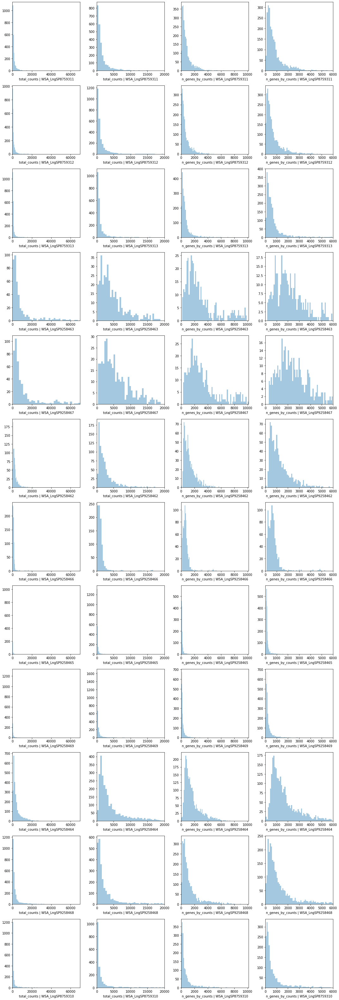

In [4]:
# PLOT QC FOR EACH SAMPLE 
fig, axs = plt.subplots(len(slides), 4, figsize=(15, 4*len(slides)-4))
for i in range(len(slides)):
    #fig.suptitle('Covariates for filtering')
    
    sns.distplot(list(slides.values())[i].obs['total_counts'], 
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['total_counts']\
                 [list(slides.values())[i].obs['total_counts']<20000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 20000)
    axs[i, 1].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts']\
                 [list(slides.values())[i].obs['n_genes_by_counts']<6000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 6000)
    axs[i, 3].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    plt.tight_layout()

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP8759310


... storing 'SYMBOL' as categorical


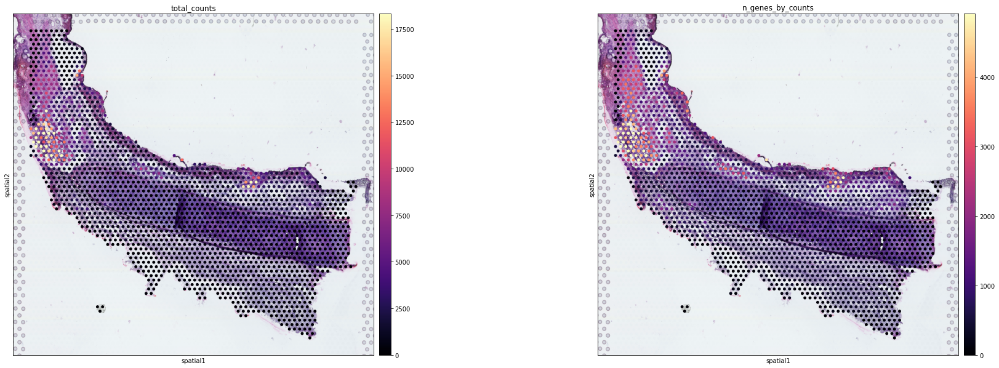

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP8759311


... storing 'SYMBOL' as categorical


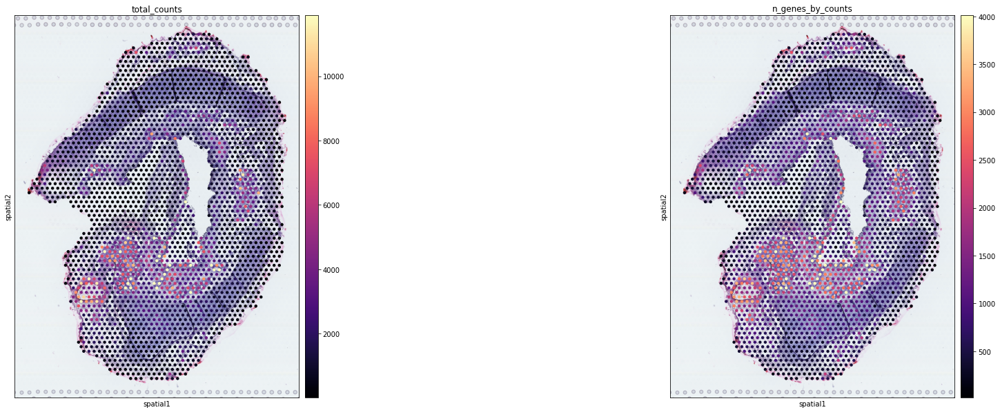

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP8759312


... storing 'SYMBOL' as categorical


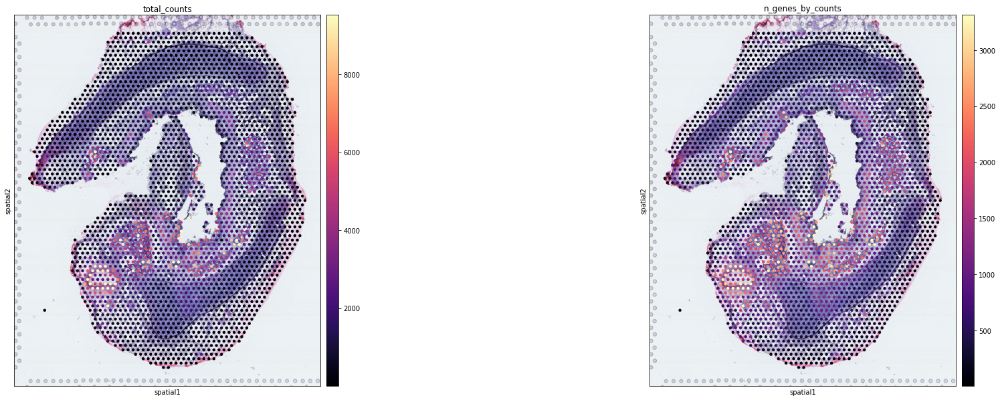

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP8759313


... storing 'SYMBOL' as categorical


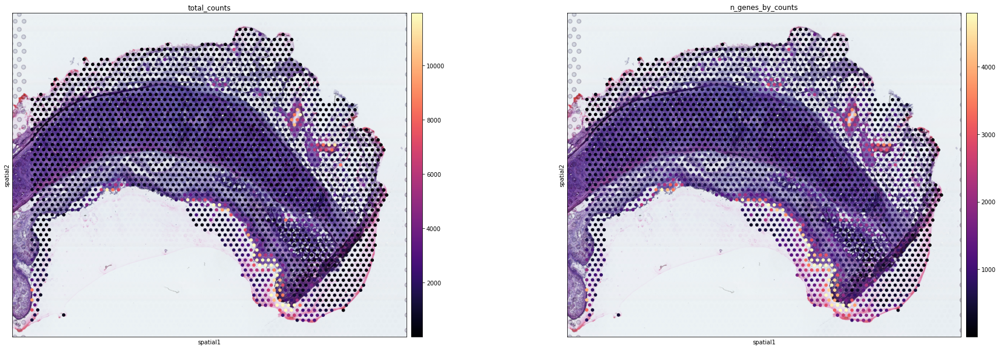

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258462


... storing 'SYMBOL' as categorical


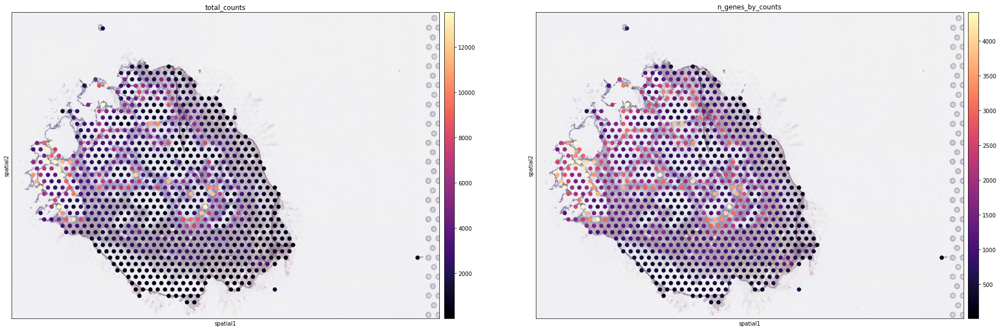

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258463


... storing 'SYMBOL' as categorical


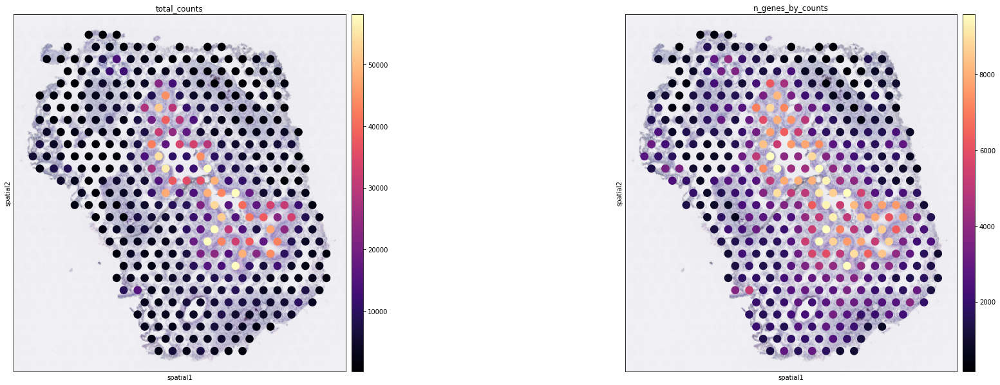

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258464


... storing 'SYMBOL' as categorical


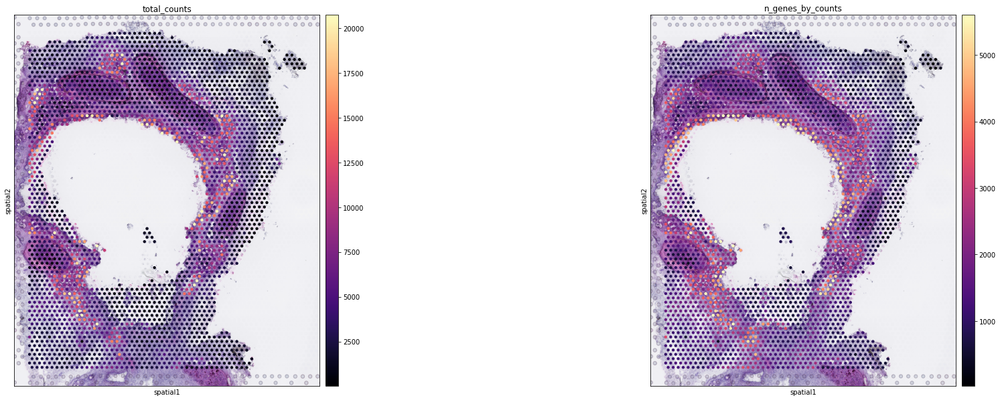

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258465


... storing 'SYMBOL' as categorical


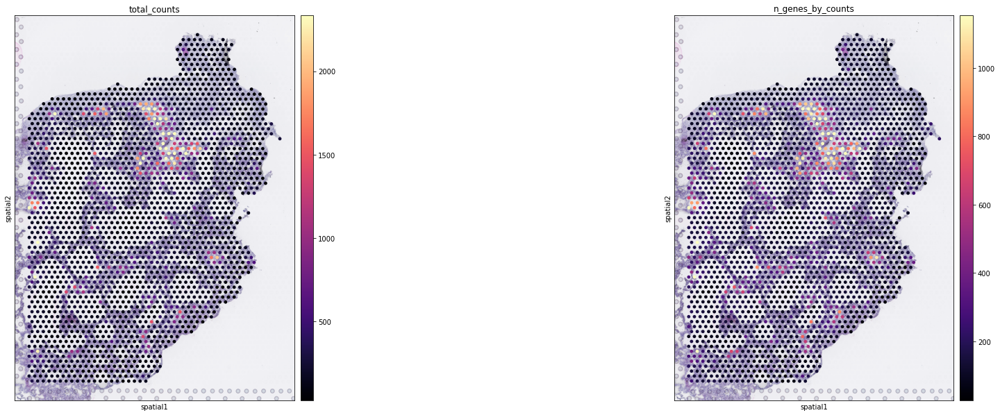

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258466


... storing 'SYMBOL' as categorical


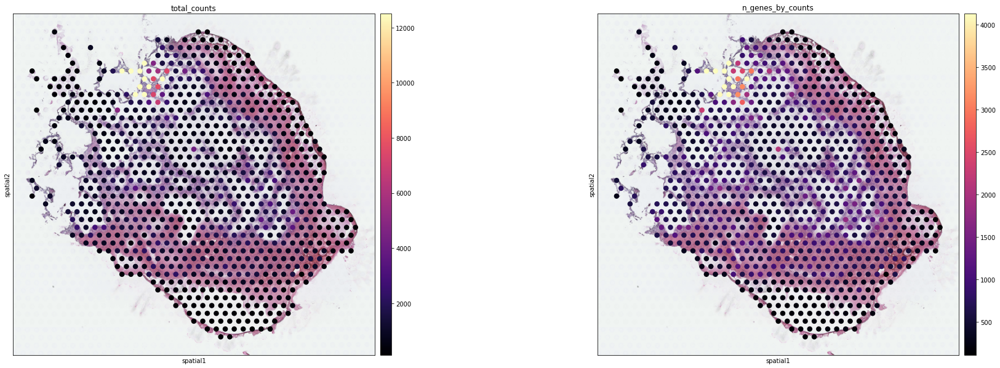

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258467


... storing 'SYMBOL' as categorical


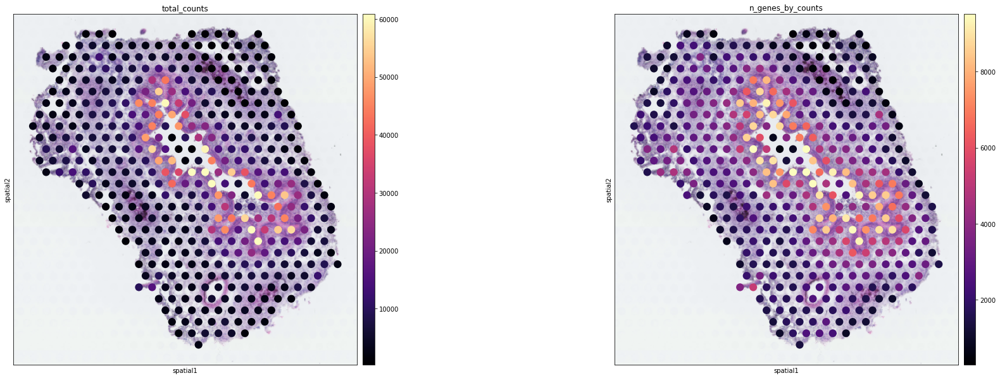

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258468


... storing 'SYMBOL' as categorical


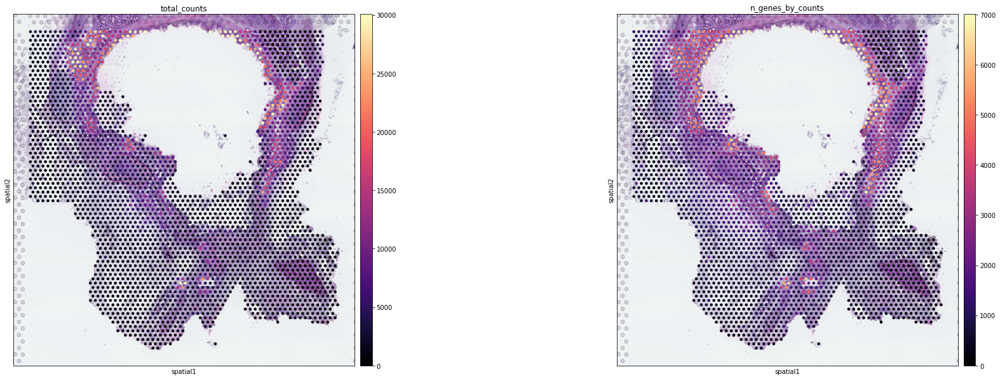

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical


WSA_LngSP9258469


... storing 'SYMBOL' as categorical


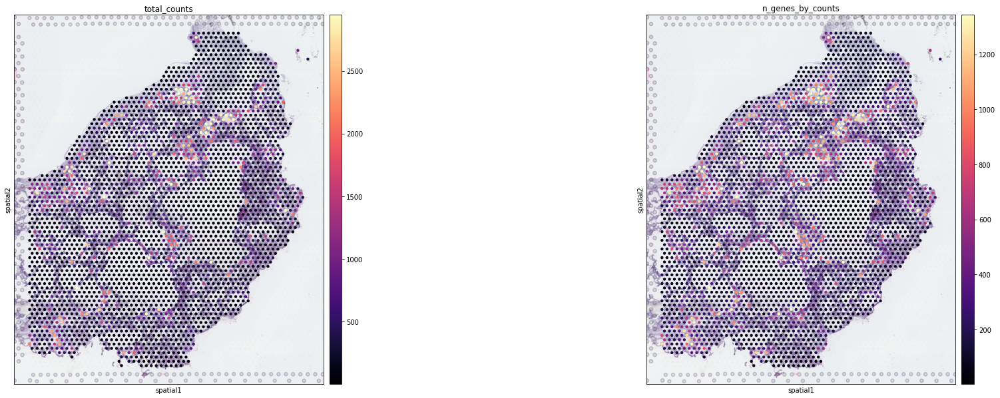

In [5]:
for s in np.unique(adata.obs['sample']):
    slide = select_slide(adata, s)
    print(s)
    with mpl.rc_context({'figure.figsize': (15, 10)}):
        sc.pl.spatial(slide, img_key = "hires", cmap='magma',
                      color=['total_counts', 'n_genes_by_counts'], size=0.9,
                      vmax='p99.0',
                      gene_symbols='SYMBOL')

Here we show how to use scanpy to plot results over histology section using anndata object from one section, and 

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


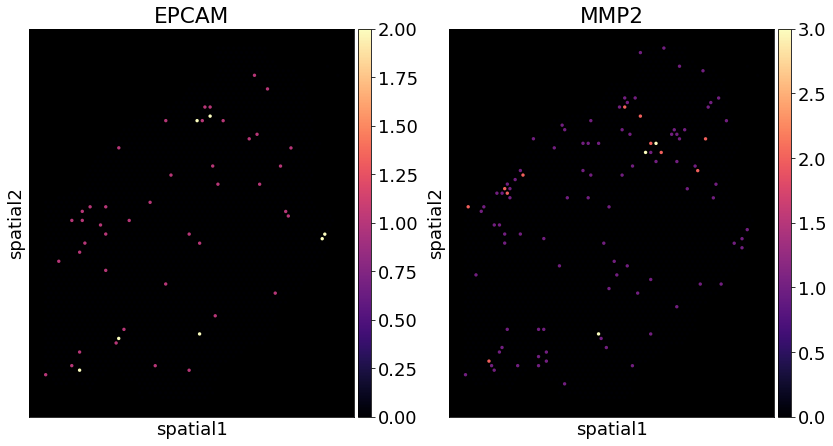

In [6]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [6,7]
rcParams["font.size"] = 18

slide = select_slide(adata, s)
sc.pl.spatial(slide, 
              color=["EPCAM", "MMP2"], img_key=None,
              vmin=0, cmap='magma', #vmax=3.8,
              gene_symbols='SYMBOL'
             )

In [7]:
## snRNA reference (raw counts)
adata_snrna_raw = anndata.read_h5ad(sc_data_folder + "lung_5loc_sc_sn_raw_final.h5ad")

adata_snrna_raw_umap = anndata.read_h5ad(sc_data_folder + "lung_5loc_sc_sn_cellxgene.h5ad")
adata_snrna_raw.obsm = adata_snrna_raw_umap[adata_snrna_raw.obs_names,:].obsm

In [8]:
adata_snrna_raw.obs.columns

Index(['Sample', 'Spatial_code', 'Loc_true', 'Material', 'scsn', 'Donor',
       'Donor_ID_2', 'Age', 'BMI', 'Smoking_status', 'Years_smoking', 'Time',
       'ID', 'Version', 'Gender', 'Study', 'n_genes', 'n_genes_by_counts',
       'total_counts', 'total_counts_mt', 'pct_counts_mt', 'PoolDon',
       'DonorPool', 'Protocol_plot', 'Donor_material', 'Batch4Correction',
       'Donor_BatchCorrection', 'Pool', 'scDonor_snBatch', 'Cohort',
       'Celltypes_master_high', 'Celltypes_master_higher',
       'Celltypes_master_higher_immune', 'Celltypes_master_2',
       'Celltypes_master_3', 'Celltypes_int'],
      dtype='object')

In [9]:
adata_snrna_raw.raw = adata_snrna_raw

### Select genes using expression in non-zero cells

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


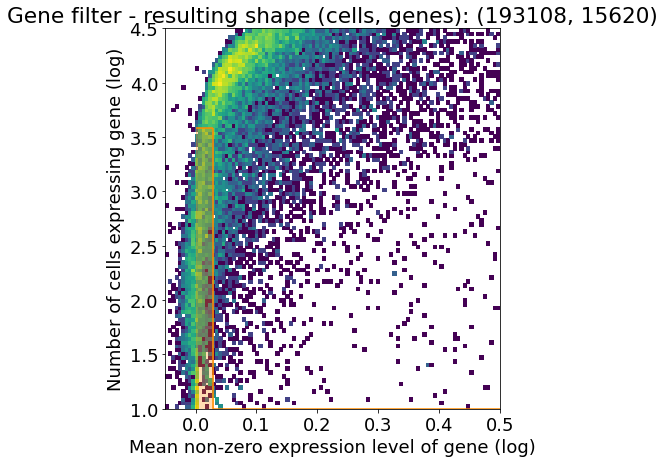

In [10]:
nonz_mean_cutoff = np.log10(1.07)
cell_count_cutoff = np.log10(10)
cell_count_cutoff2 = np.log10(adata_snrna_raw.shape[0] * 0.02)

min_genes = 100  

rcParams["axes.facecolor"] = "white"

sc.pp.filter_cells(adata_snrna_raw, min_genes=min_genes)
sc.pp.filter_genes(adata_snrna_raw, min_cells=1)

adata_snrna_raw.var['n_cells'] = np.array((adata_snrna_raw.X > 0).sum(0)).flatten()
adata_snrna_raw.var['nonz_mean'] = np.array(adata_snrna_raw.X.sum(0)).flatten() / adata_snrna_raw.var['n_cells']
    
fig, ax = plt.subplots()
ax.hist2d(np.log10(adata_snrna_raw.var['nonz_mean']),
               np.log10(adata_snrna_raw.var['n_cells']), bins=100,
               norm=mpl.colors.LogNorm(),
               range=[[-0.05,0.5], [1,4.5]]);
ax.axvspan(0,nonz_mean_cutoff, ymin=0.0, ymax=(cell_count_cutoff2-1)/3.5, color='darkorange', alpha=.3)
ax.axvspan(nonz_mean_cutoff,np.max(np.log10(adata_snrna_raw.var['nonz_mean'])), 
               ymin=0.0, ymax=(cell_count_cutoff-1)/3.5, color='darkorange', alpha=.3)
plt.vlines(nonz_mean_cutoff, cell_count_cutoff, cell_count_cutoff2, color='darkorange');
plt.hlines(cell_count_cutoff, nonz_mean_cutoff, 1, color='darkorange');
plt.hlines(cell_count_cutoff2, 0, nonz_mean_cutoff, color='darkorange');
plt.xlabel("Mean non-zero expression level of gene (log)");
plt.ylabel("Number of cells expressing gene (log)");
plt.title("Gene filter - resulting shape (cells, genes): " + str(adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2)) \
         | (np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff) \
         & np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff))].shape));
plt.show();

In [11]:
adata_snrna_raw = adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2)) \
         | (np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff) \
         & np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff))]

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [12]:
adata_snrna_raw.var['SYMBOL'] = adata_snrna_raw.var_names
adata_snrna_raw.var_names = adata_snrna_raw.var['gene_ids-1']
adata_snrna_raw.var_names.name = None

Trying to set attribute `.var` of view, copying.


In [13]:
adata_snrna_raw.raw = adata_snrna_raw

In [14]:
adata_snrna_raw.obs['Celltypes_int'].cat.categories

Index(['AT1', 'AT2', 'B_mature', 'B_naive', 'B_plasma', 'B_plasmablast',
       'Basal', 'CD4', 'CD4_TRM', 'CD4_naive/CM', 'CD8', 'CD8_CTL',
       'CD8_GZMK+', 'CD8_TRM', 'Chondrocyte', 'Ciliated', 'DC_1', 'DC_2',
       'DC_activated', 'DC_plasmacytoid', 'Deuterosomal', 'Dividing_AT2',
       'Dividing_Basal', 'Endothelia_Lymphatic', 'Endothelia_vascular_Cap_a',
       'Endothelia_vascular_Cap_g', 'Endothelia_vascular_arterial_pulmonary',
       'Endothelia_vascular_arterial_systemic',
       'Endothelia_vascular_venous_pulmonary',
       'Endothelia_vascular_venous_systemic', 'Erythrocyte', 'Fibro_ASPN',
       'Fibro_adventitial', 'Fibro_adventitial_CCL', 'Fibro_alveolar',
       'Fibro_peribronchial', 'Fibro_perichondrial', 'ILC', 'Ionocyte_n_Brush',
       'MAIT', 'Macro_CHIT1', 'Macro_CXCL10', 'Macro_MARCOneg_FCGBP_Trachea',
       'Macro_MARCOpos_Metallothioneins', 'Macro_alv', 'Macro_dividing',
       'Macro_int', 'Macro_int_CCL', 'Mast_cell', 'Megakaryocyte',
       'Mesothel

Add counts matrix as `adata.raw` 

We need to make sure gene IDs on both spatial and reference objects are of the same type. Since it is now impossible to modify the raw slot we have to use gene names for spatial data as well.

In [15]:
adata_vis = adata.copy()
#adata_vis.var_names = adata_vis.var['SYMBOL']
#adata_vis.var_names.name = 'index'
adata_vis.raw = adata_vis

In [16]:
adata_snrna_raw.obs['scDonor_snBatch']

AAACCTGGTGTGAATA-1-WTDAtest7887999-0       A32_cells
AAACGGGCAACCGCCA-1-WTDAtest7887999-0       A32_cells
AACCATGGTACAGCAG-1-WTDAtest7887999-0       A32_cells
AACGTTGGTGTCCTCT-1-WTDAtest7887999-0       A32_cells
AACTCCCTCCTAGTGA-1-WTDAtest7887999-0       A32_cells
                                             ...    
TTTGGTTGTAATGCGG-1-WSSS_A_LNG8757929-1    A42_nuclei
TTTGGTTGTGCCCTTT-1-WSSS_A_LNG8757929-1    A42_nuclei
TTTGGTTTCAAGAGTA-1-WSSS_A_LNG8757929-1    A42_nuclei
TTTGTTGAGCGAGTCA-1-WSSS_A_LNG8757929-1    A42_nuclei
TTTGTTGTCTTCTGGC-1-WSSS_A_LNG8757929-1    A42_nuclei
Name: scDonor_snBatch, Length: 193108, dtype: category
Categories (15, object): ['A26_cells', 'A32_cells', 'A37_cells', 'A40_cells', ..., 'Pool5', 'A26_nuclei', 'A42_nuclei', 'A48_nuclei']

In [17]:
adata_snrna_raw.obs

,Sample,Spatial_code,Loc_true,Material,scsn,Donor,Donor_ID_2,Age,BMI,Smoking_status,...,Donor_BatchCorrection,Pool,scDonor_snBatch,Cohort,Celltypes_master_high,Celltypes_master_higher,Celltypes_master_higher_immune,Celltypes_master_2,Celltypes_master_3,Celltypes_int
AAACCTGGTGTGAATA-1-WTDAtest7887999-0,WTDAtest7887999,1.0,d_LowLeftPar,cells,cells,A32,411C,29,22,current,...,A32_cells,nan,A32_cells,nan,AT1,Epithelia,AT1,Epithelia,Epithelia,AT1
AAACGGGCAACCGCCA-1-WTDAtest7887999-0,WTDAtest7887999,1.0,d_LowLeftPar,cells,cells,A32,411C,29,22,current,...,A32_cells,nan,A32_cells,nan,B_plasma,Immune,B_cell,Immune,Immune,B_plasma
AACCATGGTACAGCAG-1-WTDAtest7887999-0,WTDAtest7887999,1.0,d_LowLeftPar,cells,cells,A32,411C,29,22,current,...,A32_cells,nan,A32_cells,nan,Myeloid,Immune,Monocyte,Immune,Immune,Monocyte_CD16
AACGTTGGTGTCCTCT-1-WTDAtest7887999-0,WTDAtest7887999,1.0,d_LowLeftPar,cells,cells,A32,411C,29,22,current,...,A32_cells,nan,A32_cells,nan,T_NK,Immune,CD8,Immune,Immune,CD8_CTL
AACTCCCTCCTAGTGA-1-WTDAtest7887999-0,WTDAtest7887999,1.0,d_LowLeftPar,cells,cells,A32,411C,29,22,current,...,A32_cells,nan,A32_cells,nan,Myeloid,Immune,Macrophage_other,Immune,Immune,Macro_int
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTGTAATGCGG-1-WSSS_A_LNG8757929-1,WSSS_A_LNG8757929,NaN,a_Trachea,nuclei,nuclei,A42,nan,nan,nan,nan,...,A42_nuclei_none,none,A42_nuclei,WSSSAdultLung,T_NK,Immune,CD4,Immune,Immune,Tregs
TTTGGTTGTGCCCTTT-1-WSSS_A_LNG8757929-1,WSSS_A_LNG8757929,NaN,a_Trachea,nuclei,nuclei,A42,nan,nan,nan,nan,...,A42_nuclei_none,none,A42_nuclei,WSSSAdultLung,Submucosal_Glands,Epithelia,Submucosal_Glands,Epithelia,Epithelia,SMG_Mucous
TTTGGTTTCAAGAGTA-1-WSSS_A_LNG8757929-1,WSSS_A_LNG8757929,NaN,a_Trachea,nuclei,nuclei,A42,nan,nan,nan,nan,...,A42_nuclei_none,none,A42_nuclei,WSSSAdultLung,Epi_Basal,Epithelia,Epi_Basal,Epithelia,Epithelia,Basal
TTTGTTGAGCGAGTCA-1-WSSS_A_LNG8757929-1,WSSS_A_LNG8757929,NaN,a_Trachea,nuclei,nuclei,A42,nan,nan,nan,nan,...,A42_nuclei_none,none,A42_nuclei,WSSSAdultLung,Submucosal_Glands,Epithelia,Submucosal_Glands,Epithelia,Epithelia,SMG_Mucous


## 2. Show UMAP of cells and locations

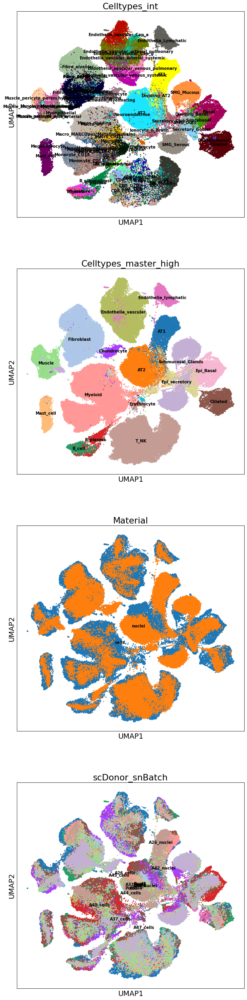

In [18]:
rcParams['figure.figsize'] = 10, 10
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['Celltypes_int', 'Celltypes_master_high', 
                                   'Material', 'scDonor_snBatch'],
           color_map = 'RdPu', ncols = 1, legend_loc='on data',
           size=30,
           legend_fontsize=10)

Now we look at the UMAP of Visium spots

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical

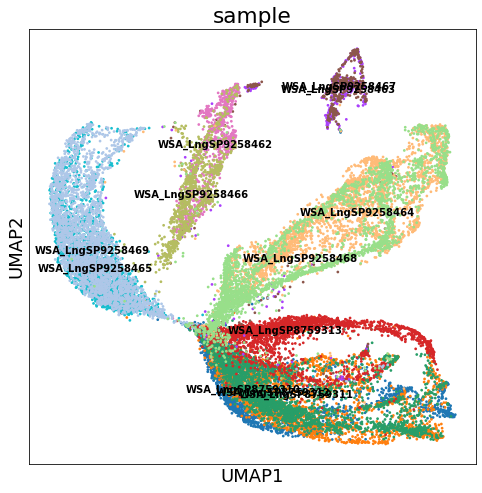

In [19]:
adata_vis_plt = adata_vis.copy()

# Log-transform (log(data + 1))
sc.pp.log1p(adata_vis_plt)

# Find highly variable genes within each sample
adata_vis_plt.var['highly_variable'] = False
for s in adata_vis_plt.obs['sample'].unique():
    
    adata_vis_plt_1 = adata_vis_plt[adata_vis_plt.obs['sample'].isin([s]), :]
    sc.pp.highly_variable_genes(adata_vis_plt_1, min_mean=0.0125, max_mean=5, min_disp=0.5, n_top_genes=1000)
    
    hvg_list = list(adata_vis_plt_1.var_names[adata_vis_plt_1.var['highly_variable']])
    adata_vis_plt.var.loc[hvg_list, 'highly_variable'] = True
    
# Scale the data ( (data - mean) / sd )
sc.pp.scale(adata_vis_plt, max_value=10)
# PCA, KNN construction, UMAP
sc.tl.pca(adata_vis_plt, svd_solver='arpack', n_comps=40, use_highly_variable=True)
sc.pp.neighbors(adata_vis_plt, n_neighbors = 20, n_pcs = 40, metric='cosine')
sc.tl.umap(adata_vis_plt, min_dist = 0.3, spread = 1)

rcParams['figure.figsize'] = 8, 8
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis_plt, color=['sample'], size=30,
           color_map = 'RdPu', ncols = 1, legend_loc='on data',
           legend_fontsize=10)

# 3. cell2location analysis in one step

### First, infer average expression in each cell type

In [20]:
reg_mod_name = 'RegressionGeneBackgroundCoverageGeneTechnologyTorch_153covariates_193108cells_15620genes_snsc_selection'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
#r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
#reg_mod = r['mod']

In [21]:
# export inferred averages in each cluster
inf_aver = adata_snrna_raw.raw.var.copy()
inf_aver = inf_aver.loc[:, ['means_cov_effect_Celltypes_int_' in i for i in inf_aver.columns]]
from re import sub
inf_aver.columns = [sub('means_cov_effect_Celltypes_int_', '', i) for i in inf_aver.columns]
#inf_aver = inf_aver.loc[aver.index, aver.columns]

# scale up by average sample scaling factor
inf_aver = inf_aver * adata_snrna_raw.uns['regression_mod']['post_sample_means']['sample_scaling'].mean()

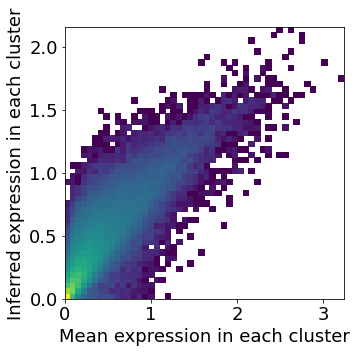

In [22]:
# compute mean expression of each gene in each cluster
aver = scvi.external.cell2location.compute_cluster_averages(adata_snrna_raw, 'Celltypes_int')
aver = aver.loc[adata_snrna_raw.var_names,:]

# export inferred averages in each cluster
#inf_aver = reg_mod.covariate_effects.copy()
#from re import sub
#inf_aver.columns = [sub('mean_cov_effect_Subset_', '', i) for i in inf_aver.columns]
#inf_aver = inf_aver.loc[aver.index, aver.columns]

rcParams['figure.figsize'] = 5, 5
plt.hist2d(np.log10(aver.values.flatten()+1), np.log10(inf_aver.values.flatten()+1),
           bins=50, norm=mpl.colors.LogNorm());
plt.xlabel('Mean expression in each cluster');
plt.ylabel('Inferred expression in each cluster');

Here we show how to perform the first step in one function run - train cell2location model to learn cell locations. Results are shown below and saved to:  

In [23]:
results_folder

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions/'

### Train scvi-cell2location

In [24]:
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_vis.var_names, inf_aver.index)
adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for scVI model
scvi.data.setup_anndata(adata=adata_vis, batch_key="sample")
scvi.data.view_anndata_setup(adata_vis)

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


INFO     Using batches from adata.obs["sample"]                                              
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Computing library size prior per batch                                              


/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/nfs/team205/vk7/sanger_projects/BayraktarLab/scvi-tools/scvi/data/_utils.py:23: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  "This dataset has some empty cells, this might fail inference."
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: Fu

INFO     Successfully registered anndata object containing 22510 cells, 15620 vars, 12       
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/nfs/team205/vk7/sanger_projects/BayraktarLab/scvi-tools/scvi/data/_utils.py:23: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  "This dataset has some empty cells, this might fail inference."


In [25]:
from scvi.external.cell2location._cell2location_v2_module import LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlphaPyroModel

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pytorch_lightning/utilities/distributed.py:69: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping val loop
  warnings.warn(*args, **kwargs)
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 15000/15000: 100%|██████████| 15000/15000 [1:28:43<00:00,  2.82it/s, v_num=1, elbo_train=6.1e+7] 


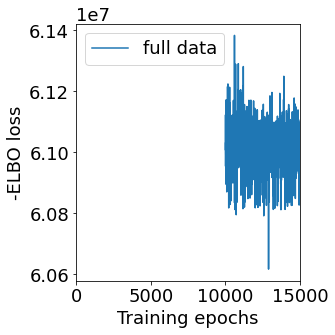

In [26]:
# create and train the model
mod = scvi.external.Cell2location(
    adata_vis, cell_state_df=inf_aver, 
    model_class=LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlphaPyroModel,
    amortised=False,# encoder_mode="single-multiple",
    #encoder_kwargs={'dropout_rate': 0.2},
    # the expected average cell abundance - user-provided, tissue-dependent hyper-prior:
    N_cells_per_location=20,
    detection_hyp_prior={"alpha": 50.0, "mean_alpha": 1.0},
) 

mod.train(max_epochs=15000, 
          batch_size=None, 
          plan_kwargs={"optim_kwargs": {"lr": 0.005, "clip_norm": 10}},
          train_size=1,
          use_gpu=True)

# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(10000)
plt.legend(labels=['full data']);

In [27]:
mod.detection_mean_

0.02375304166876877

In [28]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_vis = mod.export_posterior(
    adata_vis, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
mod.save(f"{scvi_run_name}", overwrite=True)
# can be loaded later like this:
# mod = scvi.external.Cell2location.load(f"{scvi_run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{scvi_run_name}/sp.h5ad"
adata_vis.write(adata_file)
adata_file

Sampling global variables, sample: 100%|██████████| 999/999 [01:05<00:00, 15.16it/s]


... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions//non_amortised/v1_nonamortised/sp.h5ad'

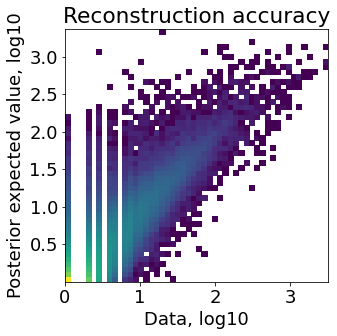

In [29]:
# Examine reconstruction accuracy to assess if there are any issues with mapping
# the plot should be roughly diagonal, strong deviations will signal problems
mod.plot_QC()

In [30]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


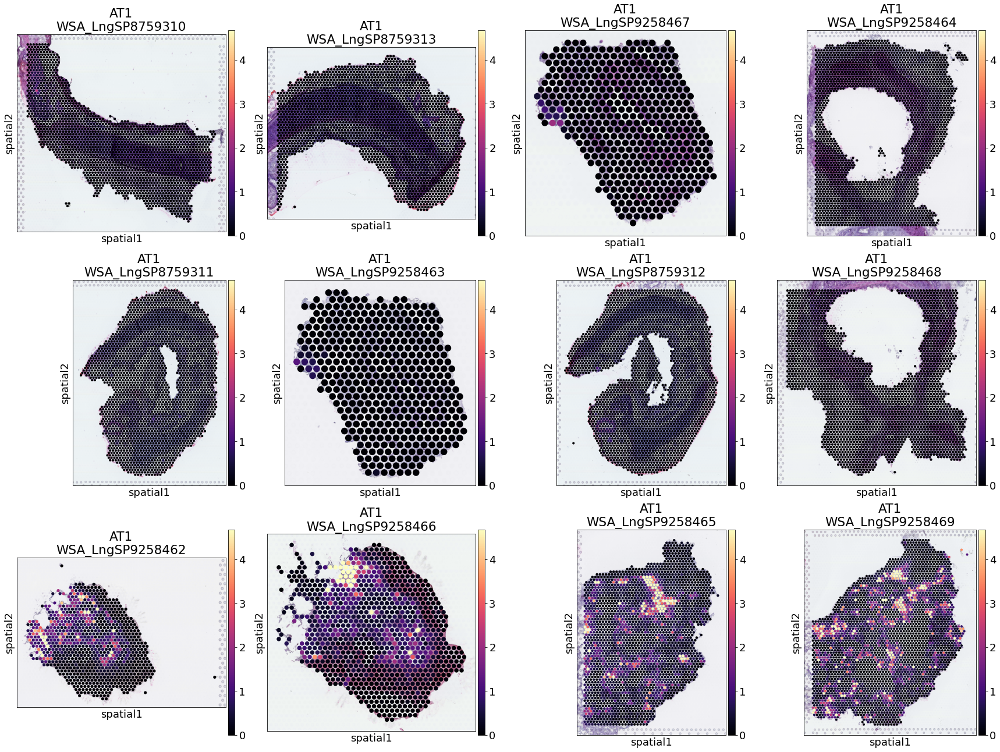

In [31]:
def plot_spatial_per_cell_type(adata, 
                               cell_type=adata_vis.uns['mod']['factor_names'][0],
                               samples=[
       'WSA_LngSP8759310', 'WSA_LngSP8759311', 'WSA_LngSP9258462',
                                    
       'WSA_LngSP8759313', 'WSA_LngSP9258463', 'WSA_LngSP9258466',
                                   
       'WSA_LngSP9258467', 'WSA_LngSP8759312', 'WSA_LngSP9258465',
       'WSA_LngSP9258464', 'WSA_LngSP9258468', 'WSA_LngSP9258469',
       #'WSA_LngSP10193345', 'WSA_LngSP10193346', 'WSA_LngSP10193347', 'WSA_LngSP10193348'
                               ],
                              ncol=4):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=(24, 18))
    
    col_name = f'{cell_type}'
    vmax = np.quantile(adata_vis.obs[col_name].values, 0.992)
    #adata_vis.obs[cell_type] = adata_vis.obs[col_name].copy()
    
    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))
    
    for i, s in enumerate(samples):
        sp_data_s = select_slide(adata, s, s_col='sample')
        sc.pl.spatial(sp_data_s, cmap='magma',
                      color=cell_type, 
                      size=1.3, img_key='hires', alpha_img=1,
                      vmin=0, vmax=vmax, ax=axs[ind[i][0],ind[i][1]], show=False
                                            )
        axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
        
    fig.tight_layout(pad=0.5)
        
    return fig

plot_spatial_per_cell_type(adata_vis, cell_type=adata_vis.uns['mod']['factor_names'][0]);

In [32]:
from re import sub
import os
for c in adata_vis.uns['mod']['factor_names']:
    fig = plot_spatial_per_cell_type(adata_vis, cell_type=c)
    fig_dir = f"{scvi_run_name}/spatial/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig_dir = f"{scvi_run_name}/spatial/per_cell_type/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig.savefig(f"{fig_dir}W_cell_abundance_q05_{sub('/', '_', c)}.png",
                bbox_inches='tight')
    fig.clear()
    plt.close(fig)

f"{scvi_run_name}/spatial/per_cell_type/"


Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attrib

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions//non_amortised/v1_nonamortised/spatial/per_cell_type/'

In [33]:
with mpl.rc_context({"axes.facecolor": "black"}):
    clust_names = adata_vis.uns['mod']['factor_names']
    
    for s in adata_vis.obs['sample'].unique():

        s_ind = adata_vis.obs['sample'] == s
        s_keys = list(adata_vis.uns['spatial'].keys())
        s_spatial = np.array(s_keys)[[s in i for i in s_keys]][0]

        fig = sc.pl.spatial(adata_vis[s_ind, :], cmap='magma',
                            color=clust_names, ncols=5, library_id=s_spatial,
                            size=1.3, img_key='hires', alpha_img=1,
                            vmin=0, vmax='p99.2',
                            return_fig=True, show=False)
        
        fig_dir = f"{scvi_run_name}/spatial/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)
        fig_dir = f"{scvi_run_name}/spatial/per_sample/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)

        plt.savefig(f"{fig_dir}W_cell_abundance_q05_{s}.png",
                    bbox_inches='tight')
        plt.close()

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


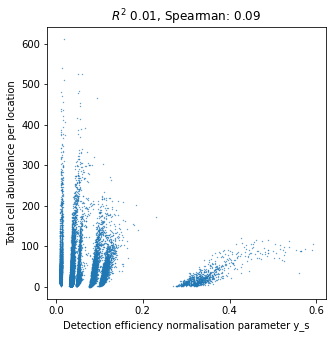

In [34]:
# compare this parameter to nUMI 
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 5]}):
    detection_eff_y_s = adata_vis.uns['mod']['post_sample_means']['detection_y_s'].flatten()
    total_UMI = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1)
    cor = np.corrcoef(detection_eff_y_s, total_UMI)[0, 1]
    from scipy.stats import spearmanr
    cor_spearmanr = spearmanr(detection_eff_y_s, total_UMI)
    
    plt.scatter(detection_eff_y_s, total_UMI,
                s=0.1);
    plt.xlabel('Detection efficiency normalisation parameter y_s');
    plt.ylabel('Total cell abundance per location');
    plt.title(f'$R^2$ {np.round(cor, 2)}, Spearman: {np.round(np.array(cor_spearmanr)[0], 2)}')

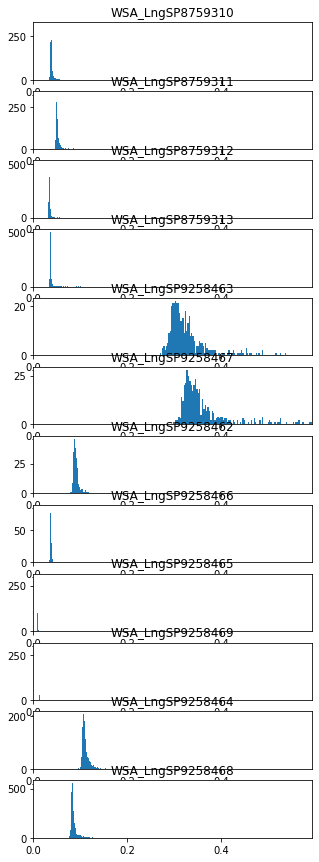

In [35]:
# look at the location detection efficiency parameter for each experiment
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 15]}):
    for i, n in enumerate(adata_vis.obs['sample'].unique()):
        plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
        x = adata_vis.uns['mod']['post_sample_means']['detection_y_s'].flatten()
        x = x[adata_vis.obs['sample'] == n]
        plt.hist(x, bins=100);
        plt.title(n)
        plt.xlim(0, adata_vis.uns['mod']['post_sample_means']['detection_y_s'].max())

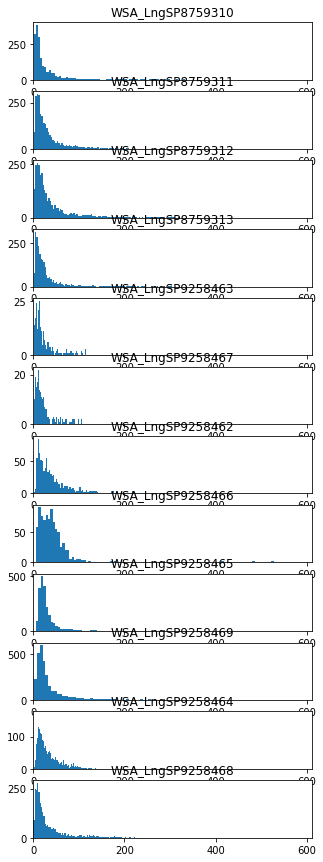

In [36]:
# look at the total cell abundance for each experiment
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 15]}):
    for i, n in enumerate(adata_vis.obs['sample'].unique()):
        plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
        total_cell_abundance = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
        total_cell_abundance_ = total_cell_abundance[adata_vis.obs['sample'] == n]
        plt.hist(total_cell_abundance_, bins=100);
        plt.title(n)
        plt.xlim(0, total_cell_abundance.max())

In [37]:
#adata_vis.uns['mod']['post_sample_means']['m_g_mean'], 
adata_vis.uns['mod']['post_sample_means']['m_g'].mean()

0.21780863

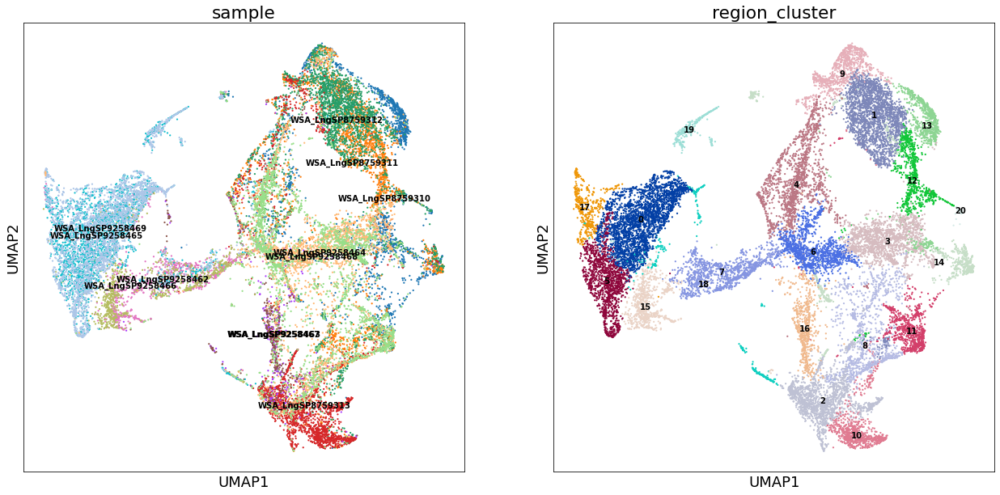

/nfs/team283/vk7/software/miniconda3farm5/envs/scvi-env2/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


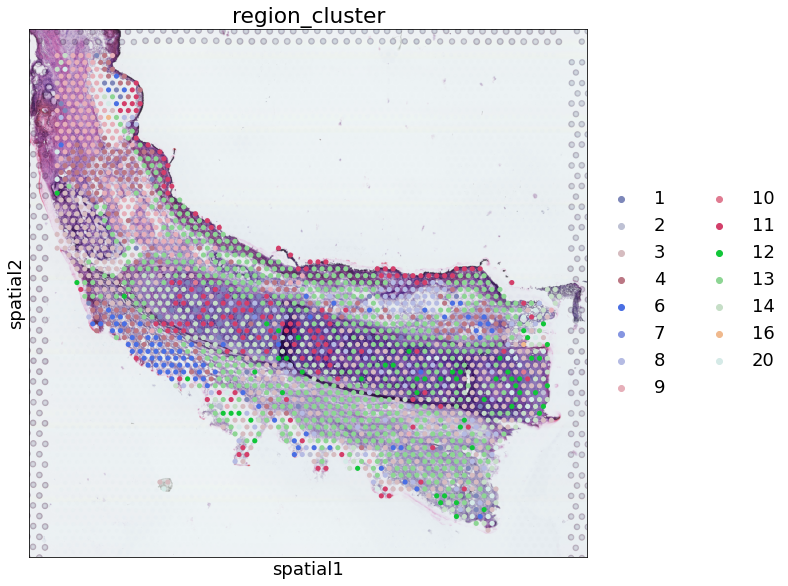

Trying to set attribute `.uns` of view, copying.


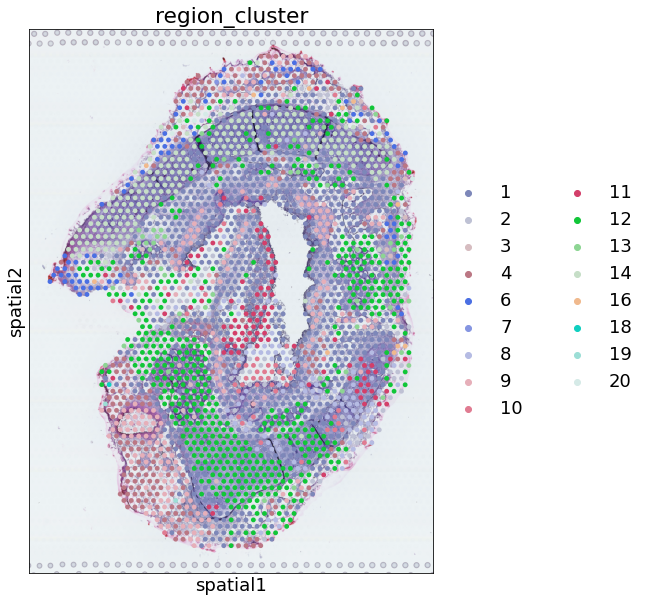

Trying to set attribute `.uns` of view, copying.


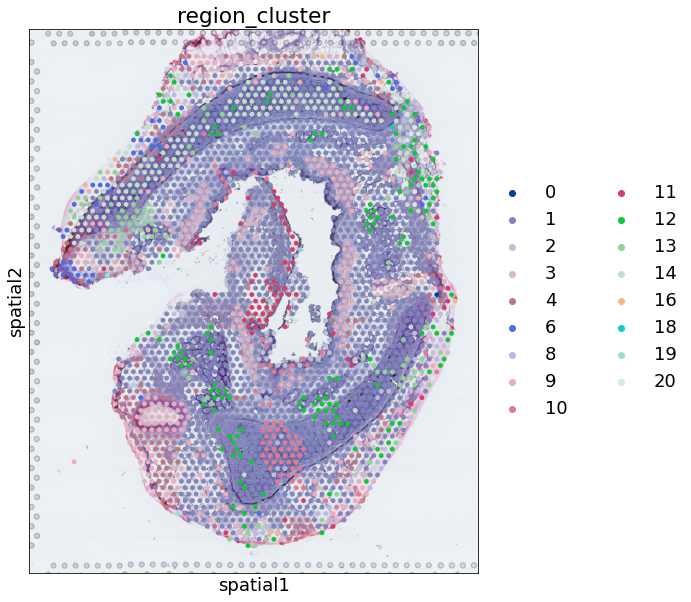

Trying to set attribute `.uns` of view, copying.


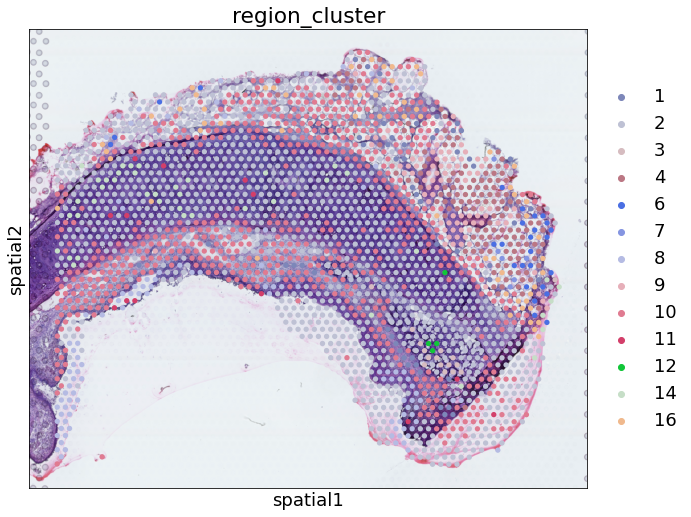

Trying to set attribute `.uns` of view, copying.


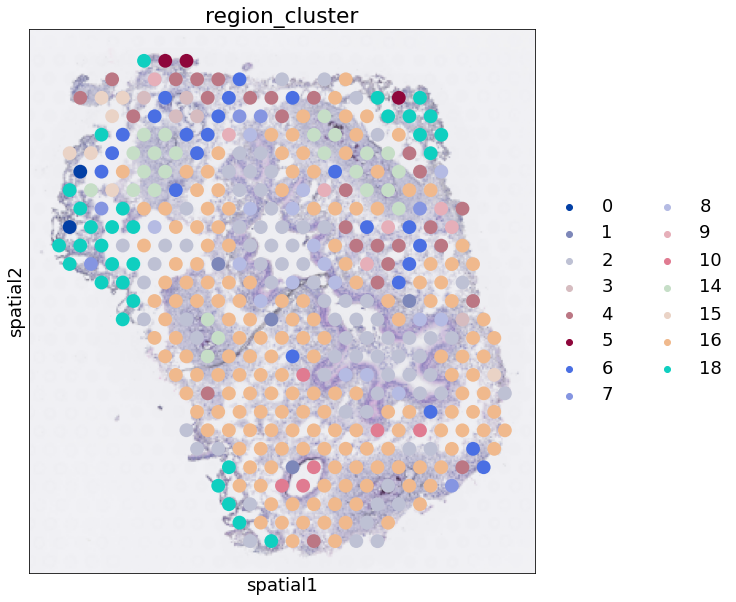

Trying to set attribute `.uns` of view, copying.


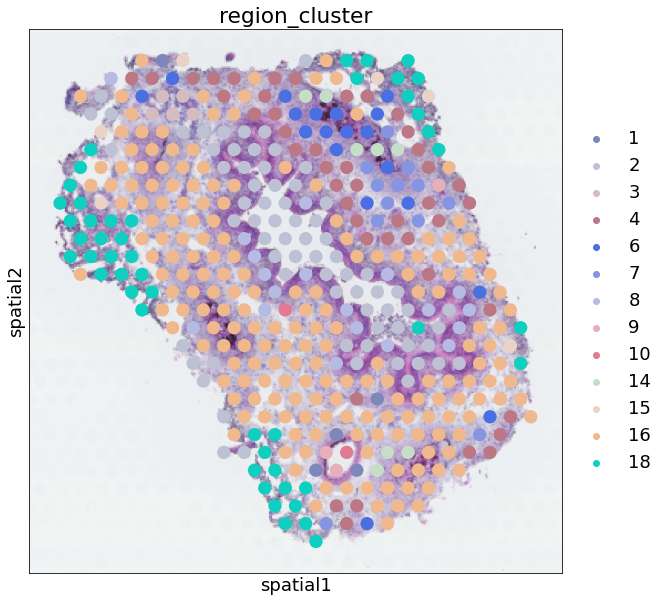

Trying to set attribute `.uns` of view, copying.


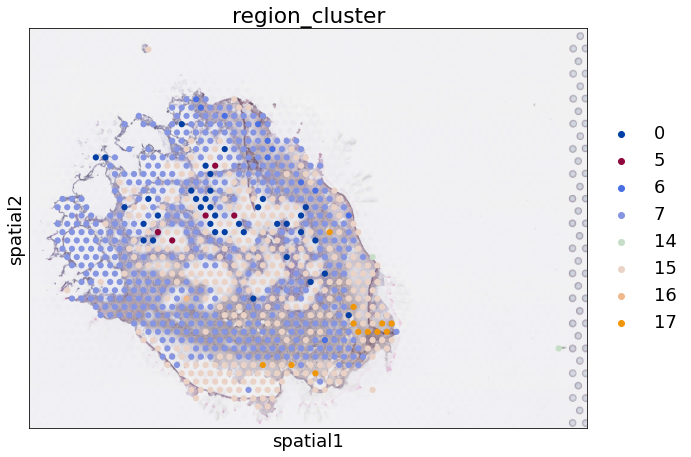

Trying to set attribute `.uns` of view, copying.


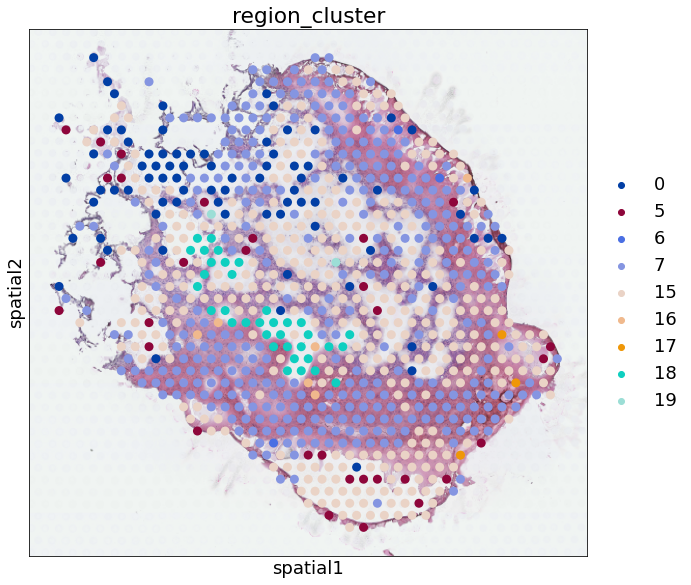

Trying to set attribute `.uns` of view, copying.


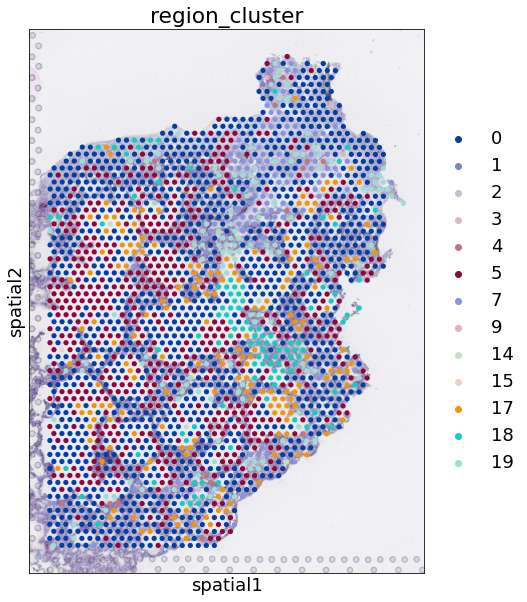

Trying to set attribute `.uns` of view, copying.


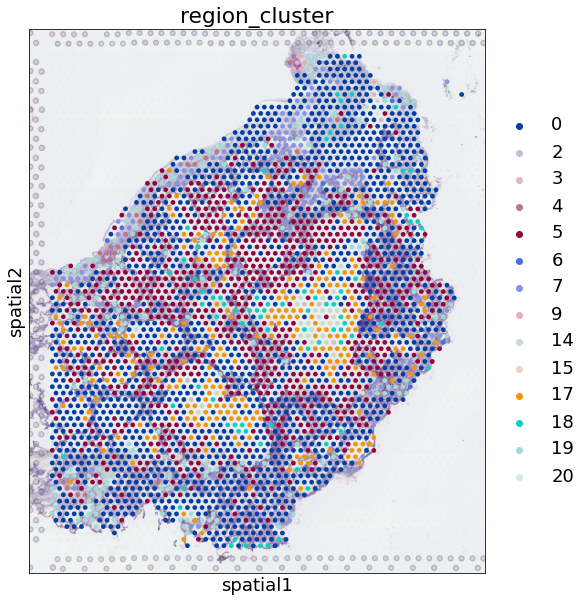

Trying to set attribute `.uns` of view, copying.


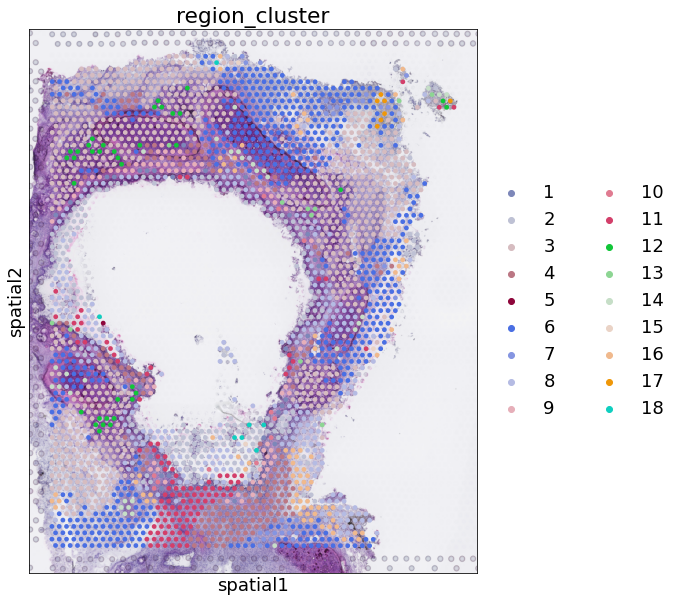

Trying to set attribute `.uns` of view, copying.


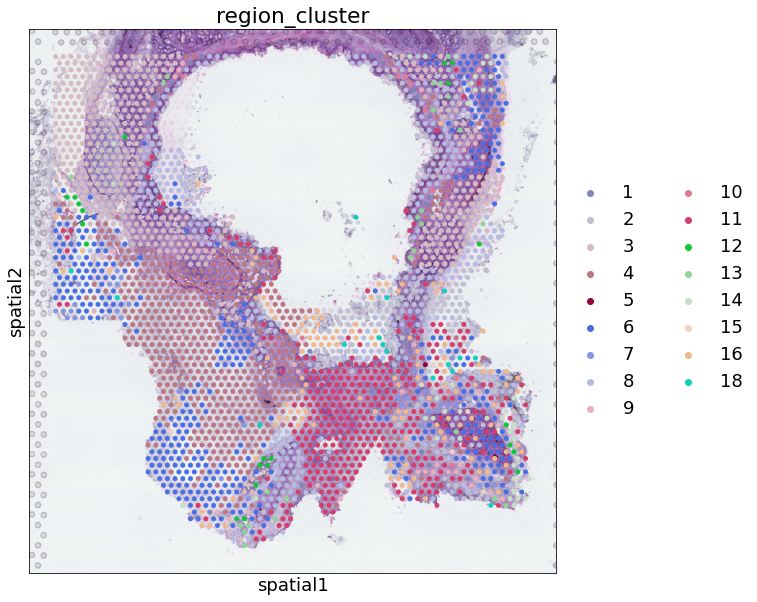

In [38]:
# compute KNN using the cell2location output
sc.pp.neighbors(adata_vis, use_rep='q05_cell_abundance_w_sf',
                n_neighbors = 20, metric='correlation')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=0.7)

adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"]
adata_vis.obs["region_cluster"] = adata_vis.obs["region_cluster"].astype("category")


sc.tl.umap(adata_vis, min_dist = 0.2, spread = 1.5)

sc.settings.figdir = f"{scvi_run_name}/"

#del adata_vis.uns['region_cluster_colors']

rcParams['figure.figsize'] = 10, 10
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis, color=['sample', 'region_cluster'],
           color_map = 'RdPu', ncols = 2, legend_loc='on data',
           legend_fontsize=10, size=20, save='umap_region_cluster.pdf')

# Plot locations of clusters
rcParams["figure.figsize"] = [10, 10]
rcParams["axes.facecolor"] = "white"

for s in list(adata_vis.obs["sample"].unique()):
    slide = select_slide(adata_vis, s)
    sel_clust = adata_vis.obs['region_cluster'].cat.categories.isin(slide.obs['region_cluster'].cat.categories)
    slide.uns['region_cluster_colors'] = list(np.array(adata_vis.uns['region_cluster_colors'])[sel_clust])
    sc.pl.spatial(slide, #library_id=s,
                  color=["region_cluster"], img_key='hires', size=1,
                  #palette=adata_vis.uns['region_cluster_colors']
                );

### Export regions for import to 10X Loupe Browser
# add binary labels for each region
region_cluster_bin = adata_vis.obs[['region_cluster']]
# save maps for each sample separately
sam = np.array(adata_vis.obs['sample'])

for i in np.unique(sam):
    
    s1 = region_cluster_bin
    s1 = s1.loc[sam == i]
    s1.index = [x[10:] for x in s1.index]
    s1.index.name = 'Barcode'
    
    s1.to_csv(f"{scvi_run_name}/"\
              +'/region_cluster29_' + i + '.csv')

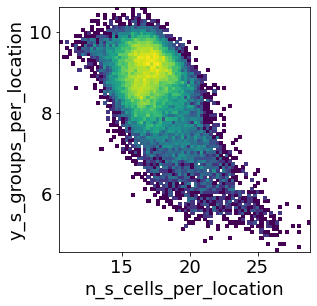

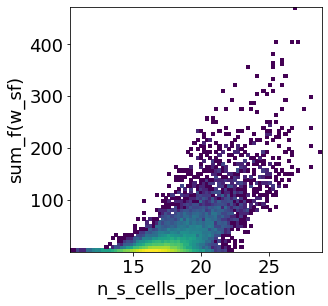

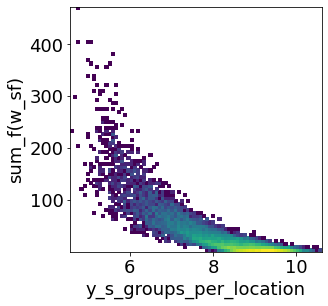

In [39]:
rcParams['figure.figsize'] = 4.5, 4.5
plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['n_s_cells_per_location'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['y_s_groups_per_location'].flatten(),
           bins=80, norm=mpl.colors.LogNorm());
plt.xlabel('n_s_cells_per_location');
plt.ylabel('y_s_groups_per_location');
plt.show()

plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['n_s_cells_per_location'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['w_sf'].sum(1).flatten(),
           bins=80, norm=mpl.colors.LogNorm());
plt.xlabel('n_s_cells_per_location');
plt.ylabel('sum_f(w_sf)');
plt.savefig(f"{scvi_run_name}/n_s_vs_w_sf.pdf");
plt.show()

plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['y_s_groups_per_location'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['w_sf'].sum(1).flatten(),
           bins=80, norm=mpl.colors.LogNorm());
plt.xlabel('y_s_groups_per_location');
plt.ylabel('sum_f(w_sf)');
plt.show()

#plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['detection_eff_y_s'].flatten(),
#           adata_vis.uns['mod']['post_sample_q05']['spot_factors'].sum(1).flatten(),
#           bins=80, norm=mpl.colors.LogNorm());
#plt.xlabel('detection_eff_y_s');
#plt.ylabel('sum(spot_factors)');
#plt.savefig(f"{results_folder}/{r['run_name']}/y_s_vs_w_sf.pdf");
#plt.show()

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


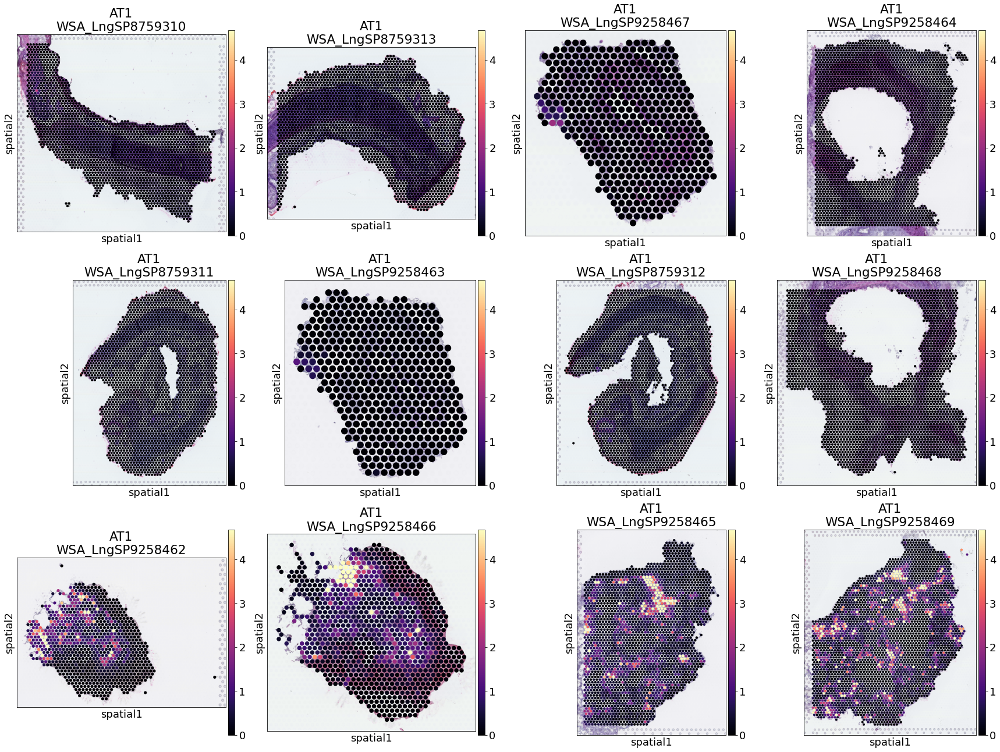

In [40]:
def plot_spatial_per_cell_type(adata, 
                               cell_type=adata_vis.uns['mod']['factor_names'][0],
                               samples=[
       'WSA_LngSP8759310', 'WSA_LngSP8759311', 'WSA_LngSP9258462',
                                    
       'WSA_LngSP8759313', 'WSA_LngSP9258463', 'WSA_LngSP9258466',
                                   
       'WSA_LngSP9258467', 'WSA_LngSP8759312', 'WSA_LngSP9258465',
       'WSA_LngSP9258464', 'WSA_LngSP9258468', 'WSA_LngSP9258469',
       #'WSA_LngSP10193345', 'WSA_LngSP10193346', 'WSA_LngSP10193347', 'WSA_LngSP10193348'
                               ],
                              ncol=4, prefix=''):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=(24, 18))
    if nrow == 1:
        axs = axs.reshape((1, ncol))
    
    col_name = f'{prefix}{cell_type}'
    vmax = np.quantile(adata_vis.obs[col_name].values, 0.992)
    adata_vis.obs[cell_type] = adata_vis.obs[col_name].copy()
    
    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))
    
    for i, s in enumerate(samples):
        sp_data_s = select_slide(adata, s, s_col='sample')
        sc.pl.spatial(sp_data_s, cmap='magma',
                      color=cell_type, 
                      size=1.3, img_key='hires', alpha_img=1,
                      vmin=0, vmax=vmax, ax=axs[ind[i][0],ind[i][1]], show=False
                                            )
        axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
        
    fig.tight_layout(pad=0.5)
        
    return fig

plot_spatial_per_cell_type(adata_vis, cell_type=adata_vis.uns['mod']['factor_names'][0]);

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


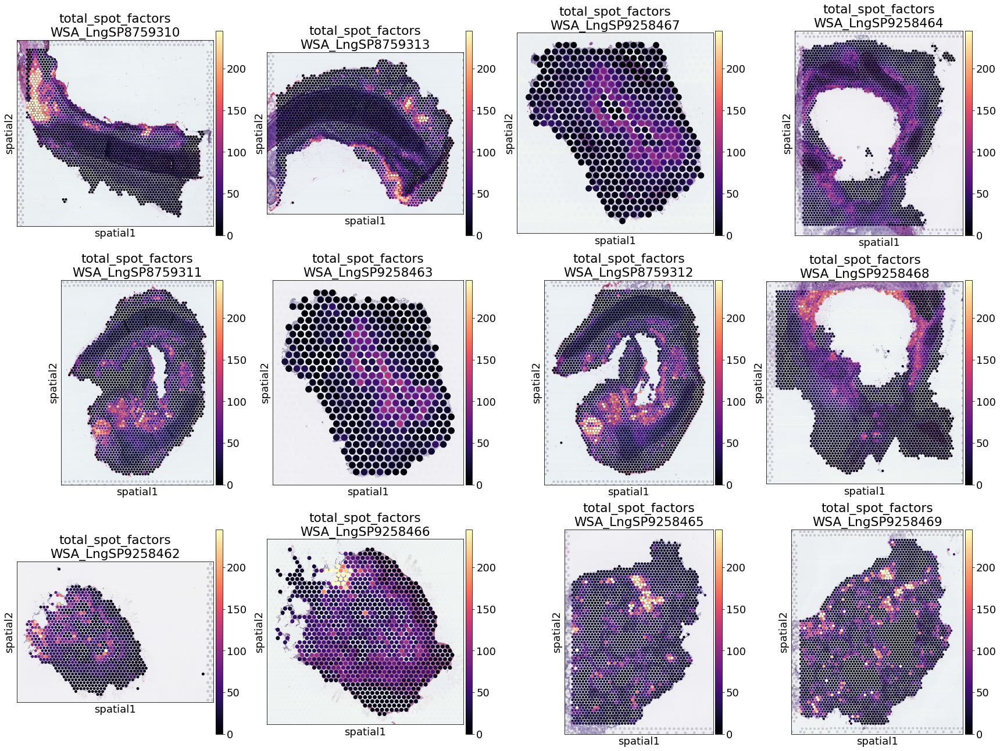

In [41]:
adata_vis.obs['total_spot_factors'] = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
plot_spatial_per_cell_type(adata_vis, cell_type='total_spot_factors', prefix='');

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


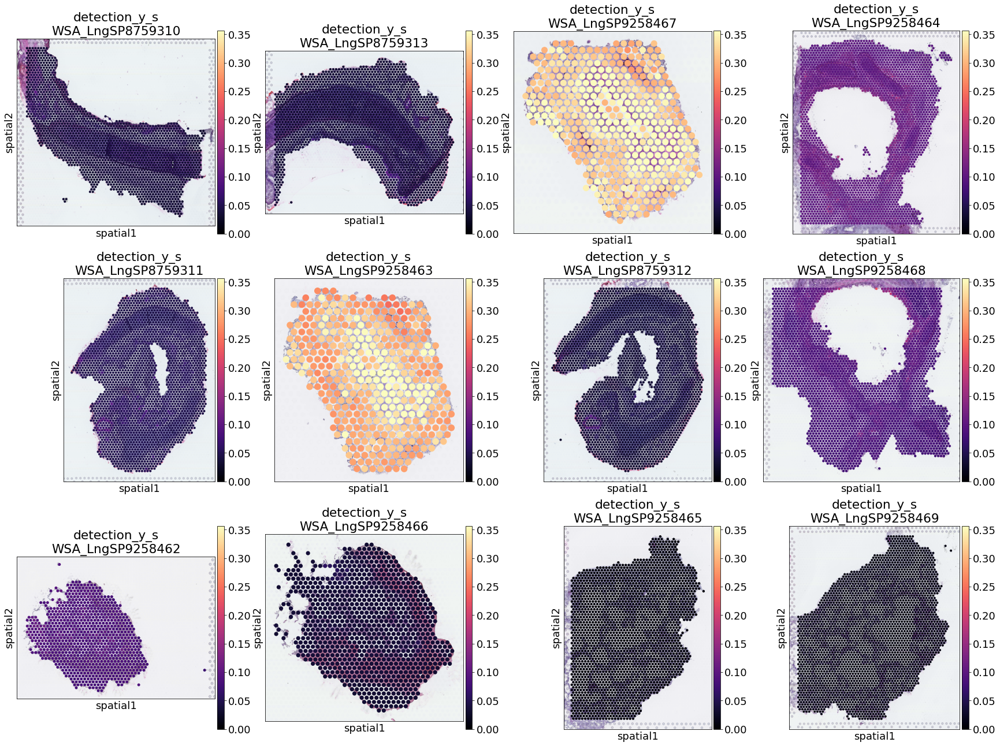

In [42]:
adata_vis.obs['detection_y_s'] = adata_vis.uns['mod']['post_sample_q05']['detection_y_s']
plot_spatial_per_cell_type(adata_vis, cell_type='detection_y_s', prefix='');

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


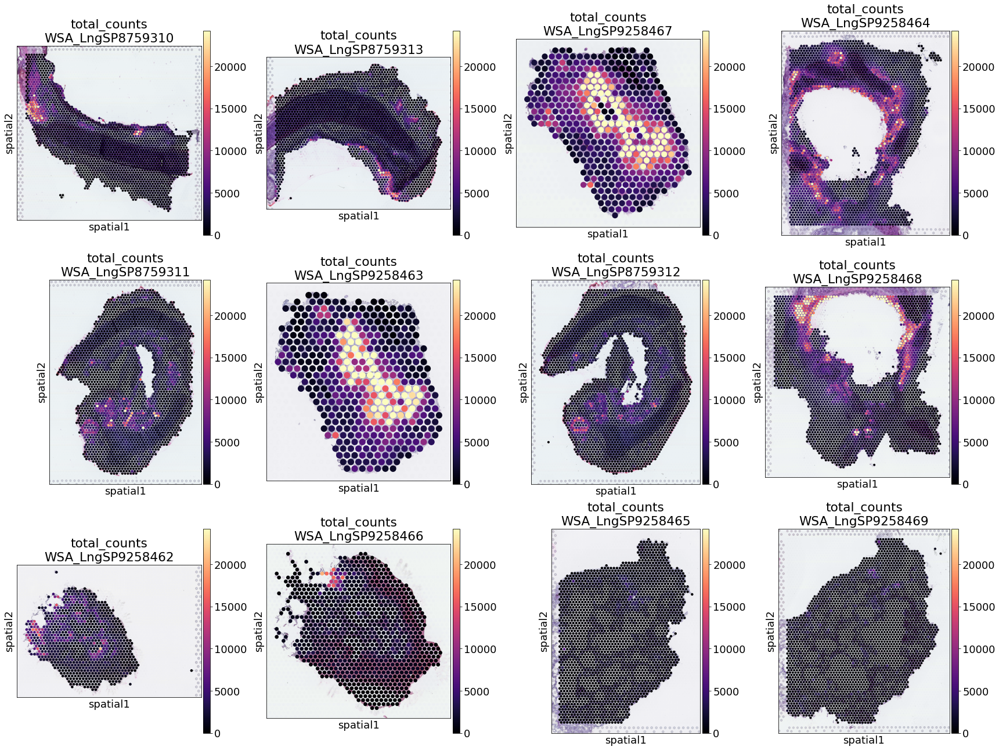

In [43]:
plot_spatial_per_cell_type(adata_vis, cell_type='total_counts', prefix='');

{'WSA_LngSP8759310': 627.8503082275383,
 'WSA_LngSP8759311': 265.6585250854492,
 'WSA_LngSP8759312': 379.0262084960938,
 'WSA_LngSP8759313': 388.37422485351647,
 'WSA_LngSP9258463': 144.71259536743153,
 'WSA_LngSP9258467': 123.83174133300781,
 'WSA_LngSP9258462': 133.67621612548828,
 'WSA_LngSP9258466': 165.98876495361327,
 'WSA_LngSP9258465': 357.05706176757803,
 'WSA_LngSP9258469': 359.79747924804684,
 'WSA_LngSP9258464': 162.21750717163084,
 'WSA_LngSP9258468': 343.45042724609374}

In [ ]:
#sc.settings.set_figure_params(dpi = 100, color_map = 'RdPu', dpi_save = 100,
#                              vector_friendly = True, format = 'pdf',
#                              facecolor='white')
from pycell2location.models.LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha import LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha
r = cell2location.run_cell2location(
    
      # Single cell reference data as anndata object (could also be pd.DataFrame with signatures)
      sc_data=inf_aver, 
      # Spatial data as anndata object
      sp_data=adata_vis[adata_vis.obs['sample'].isin(
          ['WSA_LngSP9258463', 'WSA_LngSP9258467', 'WSA_LngSP9258462', 'WSA_LngSP9258466', 'WSA_LngSP9258464']
      )],
    
      
      model_name=LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha,

      # the column in sc_data.obs that gives cluster idenitity of each cell
      summ_sc_data_args={'cluster_col': "Celltypes_hybrid"},

      train_args={'use_raw': True, # By default uses raw slots in both of the input datasets.
                  'n_iter': 45000, # Increase the number of iterations if needed (see below) 
                  'readable_var_name_col': "SYMBOL",
                  'total_grad_norm_constraint': 200,
                  'sample_name_col': 'sample'}, # Column in sp_data.obs with Sample ID

      # Number of posterios samples to use for estimating parameters,
      # reduce if not enough GPU memory
      posterior_args={'n_samples': 1000}, 

    
      export_args={'path': results_folder, # path where to save results
                   'run_name_suffix': '_45k_selection_alpha10' # optinal suffix to name the run
                  },

      model_kwargs={ # Prior on the number of cells, cell types and co-located combinations
          
                    'cell_number_prior': {
                        # Use visual inspection of the tissue image to determine 
                        # the average number of cells per spot,
                        # an approximate count is good enough:
                        'cells_per_spot': 20, 
                        # Prior on the number of cell types (or factors) in each spot
                        'factors_per_spot': 7, 
                        # Prior on the number of correlated cell type combinations in each spot
                        'combs_per_spot': 7
                    },
          
                    'detection_mean_hyp_prior':{'mean': None, 'alpha': 5},
                    'detection_alpha_hyp_prior':{'mean': 10, 'sd': 1},

                    # Prior on change in sensitivity between technologies
                    'gene_level_prior':{'mean': 1, 'alpha_mean': 3, 'alpha_sd': 1},
                    
                    'n_comb': 50, 'spot_fact_mean_var_ratio': 5,
      }
)

Trained model object can be pulled from `r['mod']`, cell locations are added to `r['sp_data']` as columns of `sp_data.obs` and all paramters of the model are exported to `sp_data.uns['mod']`. This anndata object and a csv file `W.csv` / `W_q05.csv` with cell locations are always saved to the results directory. 

When `'save_model': True`, the trained model `r['mod']` is also saved as a pickle file. You can load the model later and continue training. 

#### Evaluating training

Now we need to check if our model has trained successfully by looking at the loss / cost function over training iterations. This plot omits the first 20% of training iterations during which loss changes by orders of magnitude.

In [ ]:
r = {'run_name': 'LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha_12experiments_78clusters_22510locations_15620genes_45k_selection_alpha5'} # look up above
from IPython.display import Image
Image(filename=results_folder +r['run_name']+'/plots/training_history_without_first_20perc.png',
      width=400)

We also need to evaluate the reconstruction accuracy or how well cell types and uniform background explain spatial data bu comparing expected value of the model (Poisson mean) to observed count of each gene across locations. The ideal case is perfect diagonal plot.

In [ ]:
Image(filename=results_folder +r['run_name']+'/plots/data_vs_posterior_mean.png',
      width=400)

Finally, we need to evaluate robustness of the identified locations by comparing consistency of inferred locations between two independent training restarts.

In [ ]:
Image(filename=results_folder +r['run_name']+'/plots/evaluate_stability.png',
      width=400)

#### Loading saved results

We can load our model and associated object after training (this also needs a GPU to be available and we need to know the analysis name):

adata_vis = r['sp_data']

Alternatively we can load the results of the model saved into `sp_data`:

In [ ]:
sp_data_file = results_folder +r['run_name']+'/sp.h5ad'
adata_vis = anndata.read(sp_data_file)

#### Advanced plotting of cell locations

In [ ]:
adata_vis.obs['sample'].cat.categories

In [ ]:
def plot_spatial_per_cell_type(adata, 
                               cell_type=adata_vis.uns['mod']['fact_names'][0],
                               samples=[
       'WSA_LngSP8759310', 'WSA_LngSP8759311', 'WSA_LngSP9258462',
                                    
       'WSA_LngSP8759313', 'WSA_LngSP9258463', 'WSA_LngSP9258466',
                                   
       'WSA_LngSP9258467', 'WSA_LngSP8759312', 'WSA_LngSP9258465',
       'WSA_LngSP9258464', 'WSA_LngSP9258468', 'WSA_LngSP9258469',],
                              ncol=4):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=(24, 18))
    
    col_name = f'q05_spot_factors{cell_type}'
    vmax = np.quantile(adata_vis.obs[col_name].values, 0.992)
    adata_vis.obs[cell_type] = adata_vis.obs[col_name].copy()
    
    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))
    
    for i, s in enumerate(samples):
        sp_data_s = select_slide(adata, s, s_col='sample')
        sc.pl.spatial(sp_data_s, cmap='magma',
                      color=cell_type, 
                      size=1.3, img_key='hires', alpha_img=1,
                      vmin=0, vmax=vmax, ax=axs[ind[i][0],ind[i][1]], show=False
                                            )
        axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
        
    fig.tight_layout(pad=0.5)
        
    return fig


In [ ]:
plot_spatial_per_cell_type(adata_vis, cell_type=adata_vis.uns['mod']['fact_names'][0]);

In [ ]:
from re import sub
for c in adata_vis.uns['mod']['fact_names']:
    fig = plot_spatial_per_cell_type(adata_vis, cell_type=c)
    fig.savefig(f"{results_folder}{r['run_name']}/plots/spatial/per_cell_type/W_cell_abundance_q05_{sub('/', '_', c)}.png",
                bbox_inches='tight')
    fig.clear()
    plt.close(fig)

f"{results_folder}{r['run_name']}/plots/spatial/per_cell_type/"


Now we add cell locations to each slide to plot them over histology images.

In [ ]:
thresholds = {
 'WSA_LngSP8759310': 170, 
 'WSA_LngSP8759311': 120, 
 'WSA_LngSP8759312': 120, 
 'WSA_LngSP8759313': 120,
    
 'WSA_LngSP9258463': 500,
 'WSA_LngSP9258467': 500,
 'WSA_LngSP9258462': 150,
 'WSA_LngSP9258466': 150,
 'WSA_LngSP9258465': 30,
 'WSA_LngSP9258469': 50,
 'WSA_LngSP9258464': 150,
 'WSA_LngSP9258468': 150
}

In [ ]:
matplotlib.rc_file_defaults()

sample_ids = adata_vis.obs['sample'].unique()
fig, axs = plt.subplots(len(sample_ids), 1, figsize=(6, 6*len(sample_ids)-4))

for i, s in enumerate(sample_ids):
    
    ind = adata_vis.obs['sample'].isin([s])
    
    sc_cov = adata_vis.uns['mod']['post_sample_q05']['gene_factors'].sum(0)
    sp_weighted_cov = (adata_vis.uns['mod']['post_sample_q05']['gene_factors'] \
              * adata_vis.uns['mod']['post_sample_q05']['gene_level']).sum(0)\
    * np.quantile(adata_vis.uns['mod']['post_sample_q05']['spot_factors'][ind,:], 0.995, axis=0)
    axs[i].scatter(sc_cov, sp_weighted_cov, s=2);
    axs[i].set_ylabel('Visium total UMI weighted by q99.5(spot_factors)');
    axs[i].set_title(s);
    
    axs[i].hlines(thresholds[s], 0, 12000, color='black');
    axs[i].set_xlabel(f"scRNA total UMI \n Mapped (>{thresholds[s]}): {adata_vis.uns['mod']['fact_names'][sp_weighted_cov > thresholds[s]]}");
    
plt.tight_layout()

Alternatively we can visualise locations of multiple cell types at once using a plotting tool from cell2location package.

In [ ]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['SMG_Serous', 'Chondrocyte', 'Ciliated']
sel_clust_col = ['q05_nUMI_factors' + str(i) for i in sel_clust]
s = 'WSA_LngSP9258464'

slide = select_slide(adata_vis, s)

rcParams["figure.figsize"] = [15,15]
fig = plot_spatial(slide.obs[sel_clust_col], labels=sel_clust,
              coords=slide.obsm['spatial'] \
                      * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
              show_img=True, img_alpha=0.8,
              img=list(slide.uns['spatial'].values())[0]['images']['hires'],
              circle_diameter=4, alpha_scaling=0.5)

Now we plot the absolute cell density.

In [ ]:
rcParams["figure.figsize"] = [15,15]
sel_clust_col = ['q05_spot_factors' + str(i) for i in sel_clust]
fig = plot_spatial(slide.obs[sel_clust_col], labels=sel_clust,
              coords=slide.obsm['spatial'] \
                      * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
              show_img=True, img_alpha=0.8,
              img=list(slide.uns['spatial'].values())[0]['images']['hires'],
              circle_diameter=4, alpha_scaling=0.5)

Here we use standard scanpy pipeline to plot cell locations over histology images:

In [ ]:
rcParams["axes.facecolor"] = "white"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'WSA_LngSP9258464'

slide = select_slide(adata_vis, s)
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = slide.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]
slide.obs[sel_clust] = (slide.obs[sel_clust_col])

sc.pl.spatial(slide, cmap='magma',
              color=sel_clust[3:9], # limit size in this notebook
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0.5,
              vmin=0, vmax='p99.5'
             )

Here we plot cell density

In [ ]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'WSA_LngSP9258464'
sel_clust_col = ['q05_spot_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_spot_factors', '', i) for i in sel_clust_col]

slide = select_slide(adata_vis, s)
slide.obs[sel_clust] = (slide.obs[sel_clust_col])

sc.pl.spatial(slide, cmap='magma',
              color=sel_clust[3:9], # limit size in this notebook
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.5'
             )

## 4. Automatic discrete region identification by clustering cell densities
We find regions by clustering spots based on inferred molecule contributions of each cell type. We use leiden clustering that incorporates both the similarity of spots in cell locations and in their proximity, by including both when computing the KNN graph. Results are saved in `adata_vis.obs['leiden']`. Since the clustering is done jointly, the cluster identities match between sections.

In [ ]:
sample_type = 'q05_spot_factors'
col_ind = [sample_type in i for i in adata_vis.obs.columns.tolist()]
adata_vis.obsm[sample_type] = adata_vis.obs.loc[:,col_ind].values

# compute KNN using the cell2location output
sc.pp.neighbors(adata_vis, use_rep=sample_type,
                n_neighbors = 15, metric='correlation')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=0.7)

adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"]
adata_vis.obs["region_cluster"] = adata_vis.obs["region_cluster"].astype("category")

# Next we show these regions in a UMAP based on cell densities
sc.tl.umap(adata_vis)

rcParams['figure.figsize'] = 10, 10
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis, color=['sample', 'region_cluster'],
           color_map = 'RdPu', ncols = 2, legend_loc='on data',
           legend_fontsize=10)

# Plot locations of clusters
rcParams["figure.figsize"] = [10, 10]
rcParams["axes.facecolor"] = "white"

for s in list(adata_vis.obs["sample"].unique()):
    adata_vis_plt = adata_vis[adata_vis.obs["sample"]==s, :].copy()
    sc.pl.spatial(adata_vis_plt, library_id=s, alpha=0.5,
                  color=["region_cluster"], img_key='hires', size=1,
                  #color_map=matplotlib.cm.get_cmap('Spectral')
                );

### Export regions for import to 10X Loupe Browser
# add binary labels for each region
region_cluster_bin = adata_vis.obs[['region_cluster']]
# save maps for each sample separately
sam = np.array(adata_vis.obs['sample'])

for i in np.unique(sam):
    
    s1 = region_cluster_bin
    s1 = s1.loc[sam == i]
    s1.index = [x[10:] for x in s1.index]
    s1.index.name = 'Barcode'
    
    s1.to_csv(results_folder +r['run_name']+''\
               +'/region_cluster29_' + i + '.csv')

### Examing histograms of parameters in the model

In [ ]:
# detection level mean and overdispersion per experiment
adata_vis.uns['mod']['post_sample_means']['detection_mean']#,\
#1/(adata_vis.uns['mod']['post_sample_means']['detection_alpha_e_inv'] ** 2)

In [ ]:
# look at the additive background
plt.hist(np.log10(adata_vis.uns['mod']['post_sample_means']['gene_add'].flatten()), bins=50);
adata_vis.uns['mod']['post_sample_means']['gene_add_mean'],\
1/adata_vis.uns['mod']['post_sample_means']['gene_add_alpha_e_inv']**2

In [ ]:
# look at the location detection efficiency parameter for each experiment
for i, n in enumerate(adata_vis.obs['sample'].unique()):
    plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
    x = adata_vis.uns['mod']['post_sample_means']['detection_eff_y_s'].flatten()
    x = x[adata_vis.obs['sample'] == n]
    plt.hist(x, bins=100);
    plt.xlim(0, adata_vis.uns['mod']['post_sample_means']['detection_eff_y_s'].max())

In [ ]:
# compare this parameter to nUMI 
with matplotlib.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 5]}):
    detection_eff_y_s = adata_vis.uns['mod']['post_sample_means']['detection_eff_y_s'].flatten()
    total_UMI = adata_vis.obs['total_counts'].values.flatten()
    cor = np.corrcoef(detection_eff_y_s, total_UMI)[0, 1]
    from scipy.stats import spearmanr
    cor_spearmanr = spearmanr(detection_eff_y_s, total_UMI)
    
    plt.scatter(detection_eff_y_s, total_UMI,
                s=0.1);
    plt.xlabel('Detection efficiency normalisation parameter y_s');
    plt.ylabel('Total UMI counts');
    plt.title(f'$R^2$ {np.round(cor, 2)}, Spearman: {np.round(np.array(cor_spearmanr)[0], 2)}')

In [ ]:
# compare this parameter to nUMI 
with matplotlib.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 5]}):
    detection_eff_y_s = adata_vis.uns['mod']['post_sample_means']['detection_eff_y_s'].flatten()
    total_UMI = adata_vis.uns['mod']['post_sample_means']['spot_factors'].sum(1)
    cor = np.corrcoef(detection_eff_y_s, total_UMI)[0, 1]
    from scipy.stats import spearmanr
    cor_spearmanr = spearmanr(detection_eff_y_s, total_UMI)
    
    plt.scatter(detection_eff_y_s, total_UMI,
                s=0.1);
    plt.xlabel('Detection efficiency normalisation parameter y_s');
    plt.ylabel('Total cell abundance per location');
    plt.title(f'$R^2$ {np.round(cor, 2)}, Spearman: {np.round(np.array(cor_spearmanr)[0], 2)}')

In [ ]:
{s: np.quantile(total_UMI[adata_vis.obs['sample'] == s], 0.95) for s in adata_vis.obs['sample'].unique()}

## 6. Identify co-occuring cell type combinations using matrix factorisation

Here we use inferred cell densities as input to non-negative matrix factorisation to identify co-occuring cell type combinations.

from cell2location import run_colocation
res_dict, sp_data = run_colocation(
                   adata_vis, model_name='CoLocatedCombination_sklearnNMF',
                   verbose=False, return_all=True,
    
                   train_args={'n_fact': np.arange(10, 40), 'n_iter': 20000,
                    'sample_name_col': 'sample',
                    'mode': 'normal', 'n_type': 'restart', 'n_restarts': 5},
    
                   model_kwargs={'init': 'random', 'random_state': 0, 'nmf_kwd_args': {'tol': 0.00001}},
    
                   posterior_args={},
                   export_args={'path': results_folder + 'std_model/'+r['run_name']+'/CoLocatedComb/',
                                'run_name_suffix': ''}) 

Save resulting adata with clustering, diffusion maps and co-occuring cell type combinations.

In [ ]:
adata_file = results_folder \
                +r['run_name']+'/sp_with_clusters.h5ad'
adata_vis.write(adata_file)

In [ ]:
results_folder \
                +r['run_name']

In [ ]:
! ~/gdrive upload --parent 17j8od5uOepAI4TH6Wh8Rq6VNuDEE5-Y1 --recursive /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/lung_airway_km_regions/std_model/LocationModelLinearDependentWMultiExperimentLocationBackgroundNorm_35clusters_22510locations_13467genes_40k

Modules and their versions used for this analysis

In [ ]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass